In [1]:
import os
import pandas as pd 

In [2]:
df = pd.read_csv("Unfallorte2022_LinRef.csv", sep=";", low_memory=False)
print(df.columns)


Index(['OBJECTID', 'UIDENTSTLAE', 'ULAND', 'UREGBEZ', 'UKREIS', 'UGEMEINDE',
       'UJAHR', 'UMONAT', 'USTUNDE', 'UWOCHENTAG', 'UKATEGORIE', 'UART',
       'UTYP1', 'ULICHTVERH', 'IstStrassenzustand', 'IstRad', 'IstPKW',
       'IstFuss', 'IstKrad', 'IstGkfz', 'IstSonstige', 'LINREFX', 'LINREFY',
       'XGCSWGS84', 'YGCSWGS84'],
      dtype='object')


In [3]:
df

,OBJECTID,UIDENTSTLAE,ULAND,UREGBEZ,UKREIS,UGEMEINDE,UJAHR,UMONAT,USTUNDE,UWOCHENTAG,...,IstRad,IstPKW,IstFuss,IstKrad,IstGkfz,IstSonstige,LINREFX,LINREFY,XGCSWGS84,YGCSWGS84
0,1,01220204125013262022,1,0,54,84,2022,2,19,6,...,1,1,0,0,0,0,"506085,644000001018867","6035085,351999809965491","9,093886180000030","54,463395769999998"
1,2,01220529134013152022,1,0,57,44,2022,5,11,1,...,0,0,0,1,0,0,"593821,621226734016091","6014331,532445689663291","10,440636083000101","54,268303975000002"
2,3,01220508125013982022,1,0,59,73,2022,5,12,1,...,0,1,0,0,0,0,"540417,076000001979992","6045563,334999830462039","9,624949321000029","54,555985573000001"
3,4,01220517152013752022,1,0,3,0,2022,5,8,3,...,1,0,0,0,0,0,"609966,338422868051566","5970404,848156260326505","10,672490491000101","53,870453103000003"
4,5,01220426181013142022,1,0,61,46,2022,4,19,3,...,1,0,0,0,0,0,"533425,841011611977592","5975832,250405009835958","9,509078523000030","53,929808971999996"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
256487,256488,16221017001401169170,16,0,53,0,2022,10,11,2,...,0,1,0,0,1,0,"676158,038782960036770","5648311,105042999610305","11,508439963000100","50,959446241000101"
256488,256489,16221207001413256870,16,0,55,0,2022,12,16,4,...,1,1,0,0,0,0,"663063,752786051947623","5651066,280498039908707","11,323387069000001","50,988056225999998"
256489,256490,16221116001105235370,16,0,51,0,2022,11,7,4,...,1,1,0,0,0,0,"640640,685721814050339","5650012,880617620423436","11,003713632000000","50,984505024000001"
256490,256491,16221101001309208720,16,0,63,66,2022,11,6,3,...,0,1,1,0,0,0,"596680,147997146006674","5640181,942186550237238","10,375033228000101","50,905187818000101"


In [4]:
# Filtern der Daten für Berlin (ULAND = 11)
berlin_df = df[df['ULAND'] == 11].copy()

# Anzeigen der ersten Zeilen der gefilterten Daten
print(berlin_df.head())

# Überprüfen, wie viele Zeilen in der gefilterten Tabelle sind
print(f"Anzahl der Zeilen in der gefilterten Tabelle: {len(berlin_df)}")

        OBJECTID           UIDENTSTLAE  ULAND  UREGBEZ  UKREIS  UGEMEINDE  \
120686    120687  11220421110000075131     11        0       5          5   
120687    120688  11220222110000059031     11        0       3          3   
120689    120690  11221210110000029710     11        0       9          9   
120690    120691  11220826110000062321     11        0       1          1   
120692    120693  11220705110000019511     11        0       8          8   

        UJAHR  UMONAT  USTUNDE  UWOCHENTAG  ...  IstRad  IstPKW  IstFuss  \
120686   2022       4       15           5  ...       0       0        0   
120687   2022       2        8           3  ...       0       1        0   
120689   2022      12       12           7  ...       0       1        0   
120690   2022       8       22           6  ...       0       1        0   
120692   2022       7       12           3  ...       0       1        0   

        IstKrad  IstGkfz  IstSonstige                 LINREFX  \
120686        1

In [5]:
def classify_risk(row):
    # Categorize based on USTUNDE (Hour)
    if row['USTUNDE'] in range(1, 6):  # Nacht
        risk_level = 'hoch'
    elif row['USTUNDE'] in range(20, 24) or row['USTUNDE'] == 0:  # Abends
        risk_level = 'hoch'
    elif row['USTUNDE'] in range(6, 16):  # Früh and Mittag
        risk_level = 'leicht'
    elif row['USTUNDE'] in range(16, 20):  # Nachmittags
        risk_level = 'mittel'
    
    # Other conditions: UWochentag, UMonat, etc.
    if row['UWOCHENTAG'] in [1, 7]:  # Weekends
        risk_level = 'hoch'
    elif row['UWOCHENTAG'] in [2, 3, 4, 5, 6]:  # Weekdays
        risk_level = 'leicht'

    if row['UMONAT'] in [1, 2]:  # Winter months
        risk_level = 'hoch'
    elif row['UMONAT'] in [3, 4, 12]:  # Spring and December
        risk_level = 'mittel'
    elif row['UMONAT'] in [5, 6, 7, 8, 9, 10, 11]:  # Summer/Autumn months
        risk_level = 'leicht'

    # ULichtverhältnis
    if row['ULICHTVERH'] == 1:  # Daylight
        risk_level = 'leicht'
    elif row['ULICHTVERH'] == 2:  # Twilight
        risk_level = 'mittel'
    elif row['ULICHTVERH'] == 3:  # Darkness
        risk_level = 'hoch'

    # Strassenzustand
    if row['IstStrassenzustand'] == 2:  # Wet/Icy roads
        risk_level = 'hoch'
    elif row['IstStrassenzustand'] == 1:  # Snowy roads
        risk_level = 'mittel'
    elif row['IstStrassenzustand'] == 0:  # Dry roads
        risk_level = 'leicht'

    # UKategorie
    if row['UKATEGORIE'] == 3:  # Serious accident
        risk_level = 'hoch'
    elif row['UKATEGORIE'] == 1 or row['UKATEGORIE'] == 2:  # Less serious accidents
        risk_level = 'leicht'
    
    return risk_level

# Apply the function to create the 'risk_level' column
berlin_df['risk_level'] = berlin_df.apply(classify_risk, axis=1)

# Display the new dataframe with the risk_level column
print(berlin_df[['USTUNDE', 'UWOCHENTAG', 'UMONAT', 'ULICHTVERH', 'IstStrassenzustand', 'UKATEGORIE', 'risk_level']].head())


        USTUNDE  UWOCHENTAG  UMONAT  ULICHTVERH  IstStrassenzustand  \
120686       15           5       4           0                   1   
120687        8           3       2           0                   0   
120689       12           7      12           0                   1   
120690       22           6       8           2                   1   
120692       12           3       7           0                   0   

        UKATEGORIE risk_level  
120686           2     leicht  
120687           3       hoch  
120689           2     leicht  
120690           3       hoch  
120692           3       hoch  


In [6]:
pip install xgboost


Defaulting to user installation because normal site-packages is not writeableNote: you may need to restart the kernel to use updated packages.



In [7]:
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score

# Prepare the feature columns
X = berlin_df[['USTUNDE', 'UWOCHENTAG', 'UMONAT', 'ULICHTVERH', 'IstStrassenzustand', 'UKATEGORIE']]

# Encode the 'risk_level' column to numerical values
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(berlin_df['risk_level'])

In [8]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [9]:
# Train the model
model = XGBClassifier()
model.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [10]:
# Evaluate the model
accuracy = accuracy_score(y_test, model.predict(X_test))
print(f"Accuracy: {accuracy:.2f}")

Accuracy: 1.00


In [11]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(model, X, y, cv=5)
print(f"Cross-validation accuracy scores: {scores}")
print(f"Mean accuracy: {scores.mean():.2f}")


Cross-validation accuracy scores: [1. 1. 1. 1. 1.]
Mean accuracy: 1.00


In [12]:
print(berlin_df['risk_level'].value_counts())


risk_level
hoch      10507
leicht     1841
Name: count, dtype: int64


In [13]:
from sklearn.metrics import confusion_matrix, classification_report

y_pred = model.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))


[[2081    0]
 [   0  389]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2081
           1       1.00      1.00      1.00       389

    accuracy                           1.00      2470
   macro avg       1.00      1.00      1.00      2470
weighted avg       1.00      1.00      1.00      2470



In [14]:
# Check the unique values and counts for each feature
for feature in ['USTUNDE', 'UWOCHENTAG', 'UMONAT', 'ULICHTVERH', 'IstStrassenzustand']:
    print(f"{feature} unique values:\n{df[feature].value_counts()}\n")


USTUNDE unique values:
USTUNDE
16    22798
15    21902
17    21320
14    19969
13    18844
18    16375
12    16095
7     15651
11    14643
10    12439
19    11313
9     11087
8     11079
20     7685
6      7448
21     5877
22     4867
5      4171
23     3404
0      2600
1      2082
2      1755
4      1609
3      1479
Name: count, dtype: int64

UWOCHENTAG unique values:
UWOCHENTAG
6    41473
5    40954
4    40349
3    40338
2    38397
7    30721
1    24260
Name: count, dtype: int64

UMONAT unique values:
UMONAT
5     26565
6     26078
7     25512
8     25144
9     24436
10    23534
11    20681
3     19224
4     18740
12    16795
1     15155
2     14628
Name: count, dtype: int64

ULICHTVERH unique values:
ULICHTVERH
0    194598
2     48136
1     13758
Name: count, dtype: int64

IstStrassenzustand unique values:
IstStrassenzustand
0    197150
1     54403
2      4939
Name: count, dtype: int64



In [15]:
from sklearn.inspection import permutation_importance

# Calculate permutation importance
result = permutation_importance(model, X_test, y_test, n_repeats=30, random_state=42)

# Get the feature names from X_test
feature_names = X_test.columns


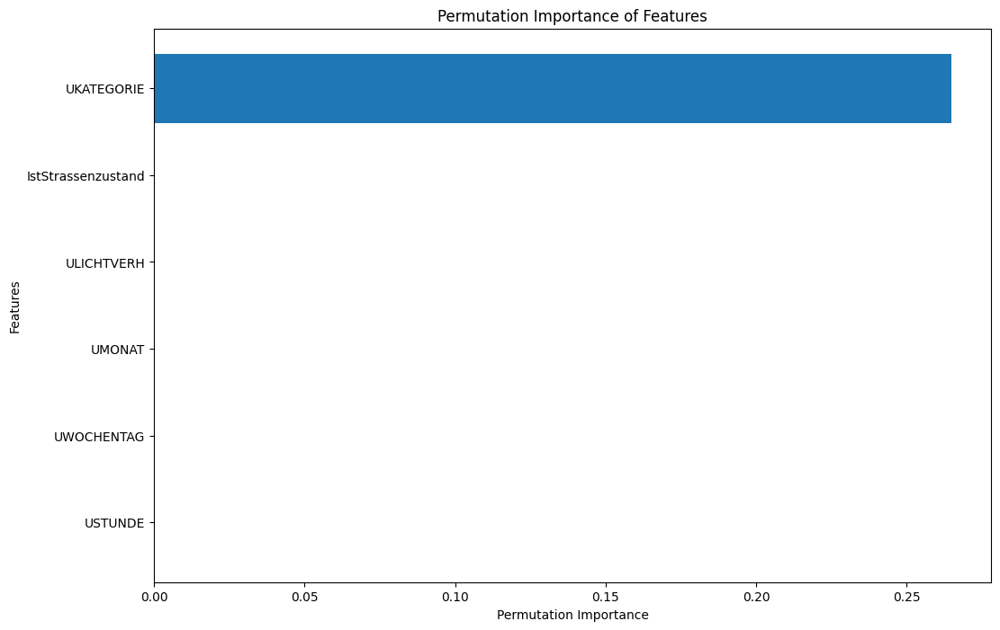

In [16]:
import matplotlib.pyplot as plt

# Sort the feature importances
sorted_idx = result.importances_mean.argsort()

# Create a horizontal bar plot
plt.figure(figsize=(12, 8))
plt.barh(feature_names[sorted_idx], result.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.ylabel('Features')
plt.title('Permutation Importance of Features')
plt.show()


In [22]:
# Konvertiere die Koordinaten von String zu Float (ersetze Kommas durch Punkte)
berlin_df['LINREFX'] = berlin_df['LINREFX'].str.replace(',', '.').astype(float)
berlin_df['LINREFY'] = berlin_df['LINREFY'].str.replace(',', '.').astype(float)


In [23]:
import geopandas as gpd
from shapely.geometry import Point

# Beispiel: Annahme, dass gdf bereits definiert ist und die entsprechenden Spalten hat

# Geometrie erstellen
geometry = [Point(xy) for xy in zip(berlin_df['LINREFX'], berlin_df['LINREFY'])]
geo_berlin_df = gpd.GeoDataFrame(berlin_df, geometry=geometry)

# CRS festlegen
geo_berlin_df.set_crs(epsg=4326, inplace=True)

# Überprüfen, ob das GeoDataFrame korrekt erstellt wurde
print(geo_berlin_df.head())


        OBJECTID           UIDENTSTLAE  ULAND  UREGBEZ  UKREIS  UGEMEINDE  \
120686    120687  11220421110000075131     11        0       5          5   
120687    120688  11220222110000059031     11        0       3          3   
120689    120690  11221210110000029710     11        0       9          9   
120690    120691  11220826110000062321     11        0       1          1   
120692    120693  11220705110000019511     11        0       8          8   

        UJAHR  UMONAT  USTUNDE  UWOCHENTAG  ...  IstFuss  IstKrad  IstGkfz  \
120686   2022       4       15           5  ...        0        1        0   
120687   2022       2        8           3  ...        0        0        0   
120689   2022      12       12           7  ...        0        0        0   
120690   2022       8       22           6  ...        0        0        0   
120692   2022       7       12           3  ...        0        1        0   

        IstSonstige        LINREFX       LINREFY           XGCSWGS84

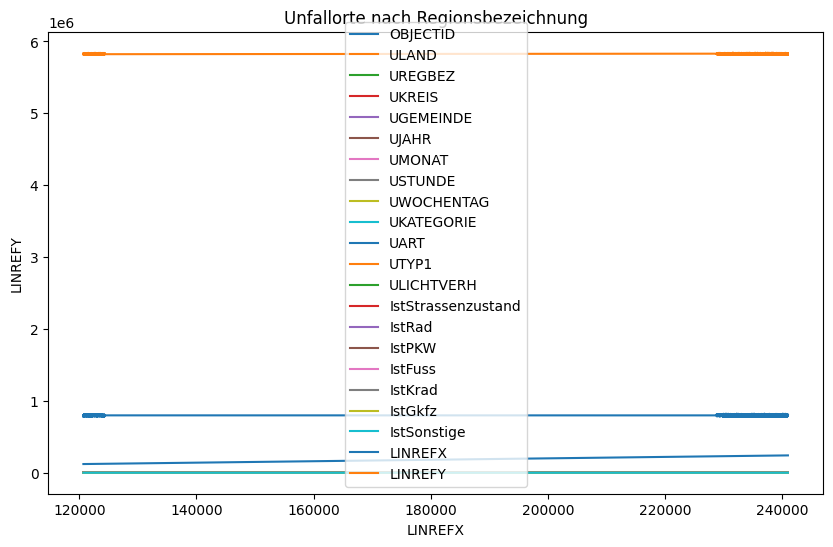

In [26]:
import matplotlib.pyplot as plt  # Stelle sicher, dass matplotlib importiert ist

# Plot der Unfallorte nach UREGBEZ
berlin_df.plot(column='UREGBEZ', legend=True, figsize=(10, 6))
plt.title('Unfallorte nach Regionsbezeichnung')
plt.xlabel('LINREFX')
plt.ylabel('LINREFY')
plt.show()


In [31]:
import geopandas as gpd
from shapely.geometry import Point
import pandas as pd
import matplotlib.pyplot as plt

In [35]:
# Filtern der Daten für Berlin (ULAND = 11)
berlin_df = berlin_df[berlin_df['ULAND'] == 11].copy()


LINREFX    float64
LINREFY    float64
dtype: object


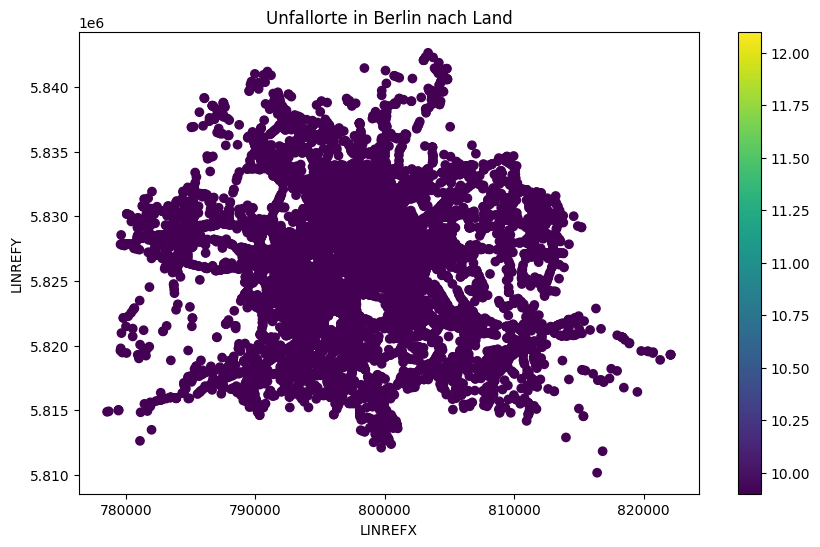

In [36]:
#Check if LINREFX and LINREFY are float types
print(berlin_df[['LINREFX', 'LINREFY']].dtypes)

#Create geometry if coordinates are float
if berlin_df['LINREFX'].dtype == 'float64' and berlin_df['LINREFY'].dtype == 'float64':
    geometry = [Point(xy) for xy in zip(berlin_df['LINREFX'], berlin_df['LINREFY'])]
    geo_gdf = gpd.GeoDataFrame(berlin_df, geometry=geometry)

    # Plot accident locations based on ULAND
    geo_gdf.plot(column='ULAND', legend=True, figsize=(10, 6))
    plt.title('Unfallorte in Berlin nach Land')
    plt.xlabel('LINREFX')
    plt.ylabel('LINREFY')
    plt.show()
else:
    print("Die Koordinaten sind nicht im richtigen Format. Bitte überprüfen!")

In [40]:
%matplotlib inline

In [43]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# Load your dataset (ensure you have loaded the DataFrame correctly)
# berlin_df = pd.read_csv('Unfallorte2022_LinRef.csv')  # Uncomment and adjust to your needs

# Check the data types of the columns
print(berlin_df[['XGCSWGS84', 'YGCSWGS84']].dtypes)

# Convert coordinates from string to float (replace commas with dots if they are strings)
def convert_to_float(series):
    return series.str.replace(',', '.').astype(float)

# Apply conversion only if the columns are of object type
if berlin_df['XGCSWGS84'].dtype == 'object':
    berlin_df['XGCSWGS84'] = convert_to_float(berlin_df['XGCSWGS84'])
if berlin_df['YGCSWGS84'].dtype == 'object':
    berlin_df['YGCSWGS84'] = convert_to_float(berlin_df['YGCSWGS84'])

# Create geometry column from the coordinates
berlin_df['geometry'] = berlin_df.apply(lambda row: Point(row['XGCSWGS84'], row['YGCSWGS84']), axis=1)

# Convert DataFrame to GeoDataFrame
geo_gdf = gpd.GeoDataFrame(berlin_df, geometry='geometry', crs="EPSG:25833")  # UTM Zone 33N for Berlin

# Transform coordinates to WGS84 (EPSG:4326)
geo_gdf = geo_gdf.to_crs(epsg=4326)

# Visualize the points on the map
geo_gdf.explore(color='blue', marker_kwds={'radius': 5}, tooltip=['UIDENTSTLAE', 'UREGBEZ'])


XGCSWGS84    float64
YGCSWGS84    float64
dtype: object


In [44]:
print(berlin_df[['XGCSWGS84', 'YGCSWGS84']].head())


        XGCSWGS84  YGCSWGS84
120686  13.140325  52.488994
120687  13.390336  52.618571
120689  13.467081  52.485329
120690  13.364311  52.501488
120692  13.435093  52.462184


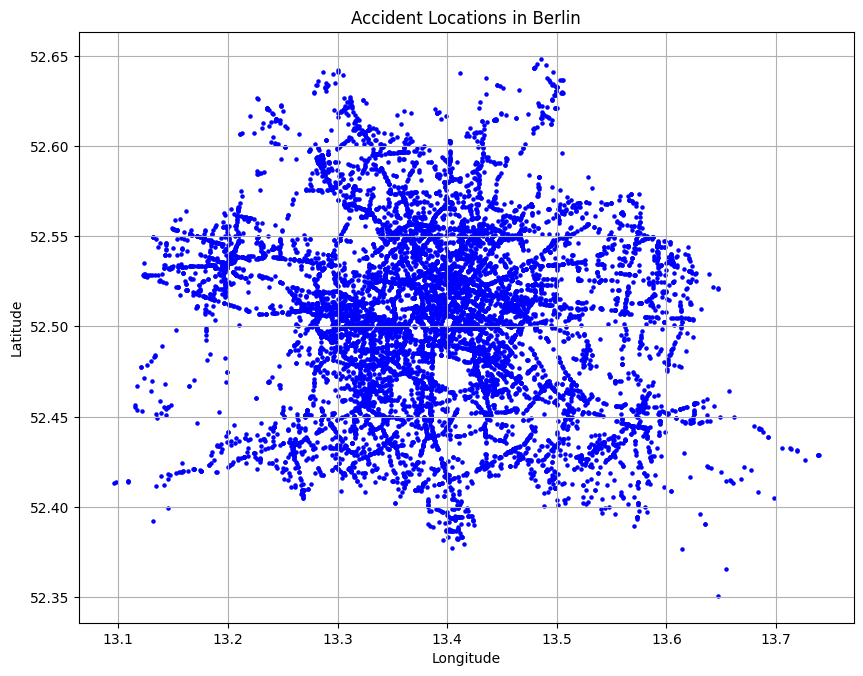

In [45]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point

# Create geometry from the coordinates
berlin_df['geometry'] = berlin_df.apply(lambda row: Point(row['XGCSWGS84'], row['YGCSWGS84']), axis=1)

# Convert to GeoDataFrame
geo_gdf = gpd.GeoDataFrame(berlin_df, geometry='geometry', crs="EPSG:4326")

# Plot the coordinates
base = geo_gdf.plot(figsize=(10, 10), color='blue', markersize=5)
plt.title('Accident Locations in Berlin')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid()
plt.show()


In [46]:
pip install folium


Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [47]:
import folium
from shapely.geometry import Point

# Assuming geo_gdf is already created and contains the coordinates

# Zentrales Koordinatensystem für die Karte (z.B. Berlin)
center = [52.5200, 13.4050]  # Berlin

# Erstellen einer Folium-Karte
m = folium.Map(location=center, zoom_start=12)

# Hinzufügen der Punkte
for _, row in geo_gdf.iterrows():
    folium.Marker(
        location=[row['geometry'].y, row['geometry'].x],
        popup=f'UID: {row["UIDENTSTLAE"]}, UREGBEZ: {row["UREGBEZ"]}',
        icon=folium.Icon(color='blue')
    ).add_to(m)

# Anzeige der Karte
m.save("berlin_accidents_map.html")  # Speichern der Karte in einer HTML-Datei
m
